# Hesitation analysis nb
Nb for testing out somr functions and other stuff for hesitation analysis

In [1]:
%load_ext autoreload
%autoreload 2

In [16]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from pythonlib.tools.stroketools import *
from drawmonkey.tools.utils import *
from pyvm.tools.preprocess import *
from pyvm.classes.videoclass import Videos
from pythonlib.tools.expttools import load_yaml_config
from pyvm.globals import BASEDIR
from drawmonkey.tools.handtrack import HandTrack, getTrialsCameraFrametimes
from pyvm.utils.directories import get_metadata
import argparse
import matplotlib.pyplot as plt
import os
import pickle
from pythonlib.drawmodel.strokePlots import *

In [3]:
def flip_save_dict_keys(dict_in):
	#Quick funciton to make df keys better instead of just generating it better
	new_df = {}
	for trial, coefs_dict in dict_in.items():
		for coefs,dat in coefs_dict.items():
			if coefs not in new_df.keys():
				new_df[coefs] = {}
			new_df[coefs][trial] = dat
	return new_df

In [14]:
#Add data here as needed
decide_data_dict = {
    'diego1': ('Diego','220913_dirgrammardiego5d'),
    'diego2': ('Diego','231118_gramdiego1b'),
    'pancho1': ('Pancho','231114_grampancho1')
}

#Change key here ot chaneg what data being used in the plotting
key_to_use = 'diego2'

animal = decide_data_dict[key_to_use][0]
name = decide_data_dict[key_to_use][1]
#Only work if 1 session
date = name.split('_')[0]
expt = name.split('_')[1]

In [22]:
dat_dir = f'/home/danhan/freiwaldDrive/dhanuska/hand_track/{animal}/{name}/processed_data.pkl'
with open(dat_dir,'rb') as f:
    dat_load = pickle.load(f)
#Only work if one session
fd = loadSingleDataQuick(animal,date,expt,1)
fd['params']['sample_rate'] = fd['params']['sample_rate'][0]



OUTDICT {'base_dir': ['/home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl'], 'base_dir_server': ['/home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl'], 'base_dir_server_2': []}
OUTDICT {'base_dir': ['/home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl'], 'base_dir_server': ['/home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl'], 'base_dir_server_2': []}
-- loaded presaved data: /home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl
OUTDICT {'base_dir': ['/home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl'], 'base_dir_server': ['/home/danhan/freiwaldDrive/kgupta/macaque_data/Diego/231118/231118_105826_gramdiego1b_Diego_1.pkl'], 'base_dir_server_2': []}


In [6]:
dat_trials = dat_load['220914_f12_dlc']

In [7]:
gaps = []
for trial,d in dat_trials.items():
    if len(d) != 0:
        for gap in d['trans_gaps_cam'][1:-1]:
            gaps.append(np.array(gap))


In [8]:
print(dat_trials[61].keys())

dict_keys(['strokes_cam', 'gaps_cam', 'pts_time_cam_all', 'strokes_touch', 'strokes_task', 'pnut_strokes', 'reg_strokes_cam', 'reg_gaps_cam', 'reg_pts_time_cam_all', 'trans_strokes_cam', 'trans_gaps_cam', 'trans_pts_time_cam_all'])


In [9]:
print(len(dat_trials))

852


/home/danhan/Documents/pipeline/setup/pythonlib/pythonlib/tools/stroketools.py:2532: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(20,10))


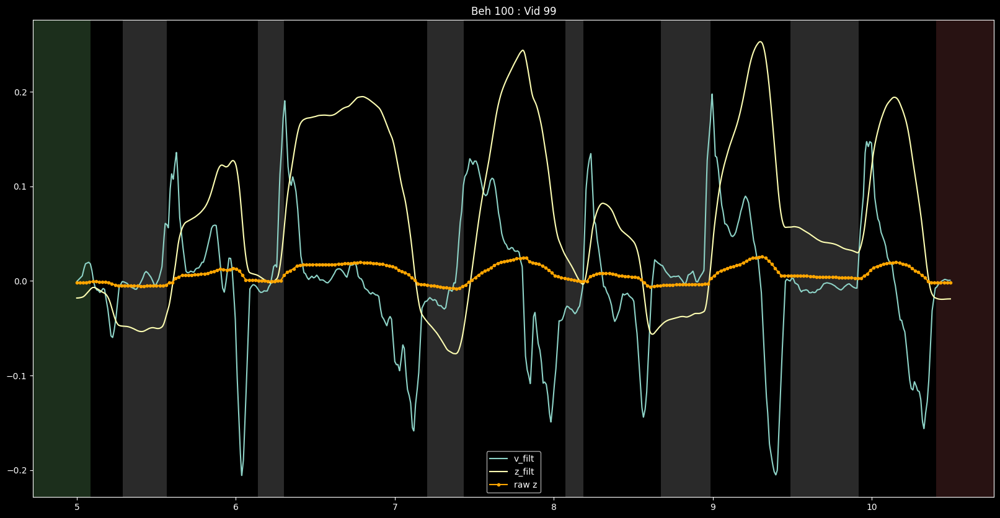

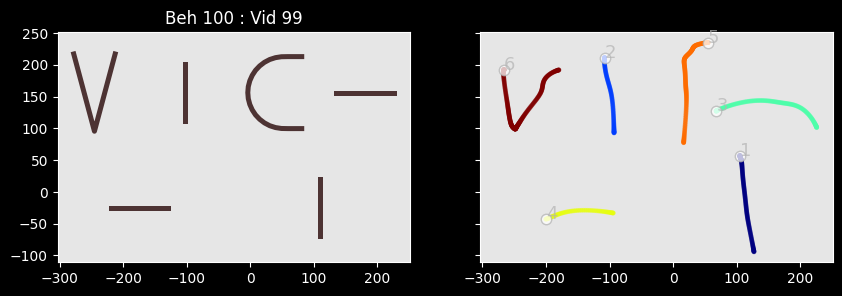

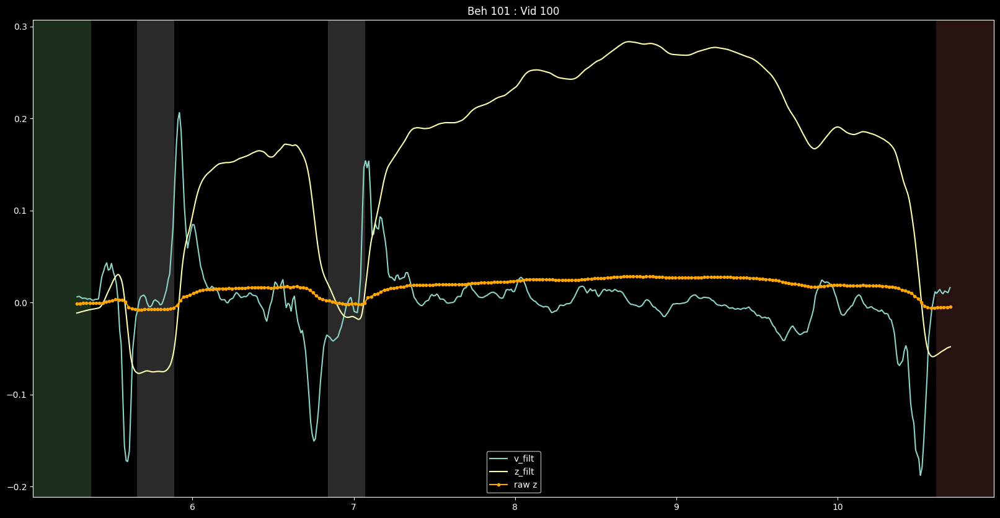

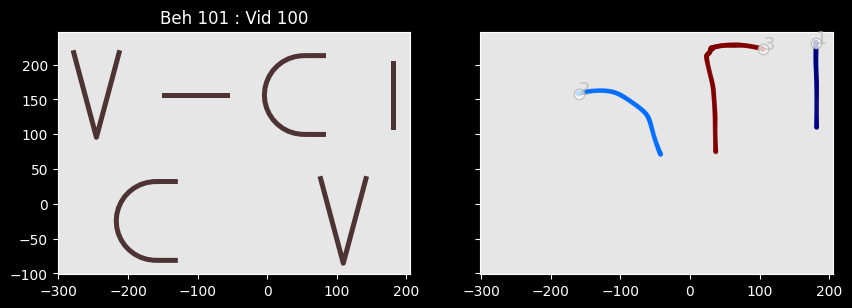

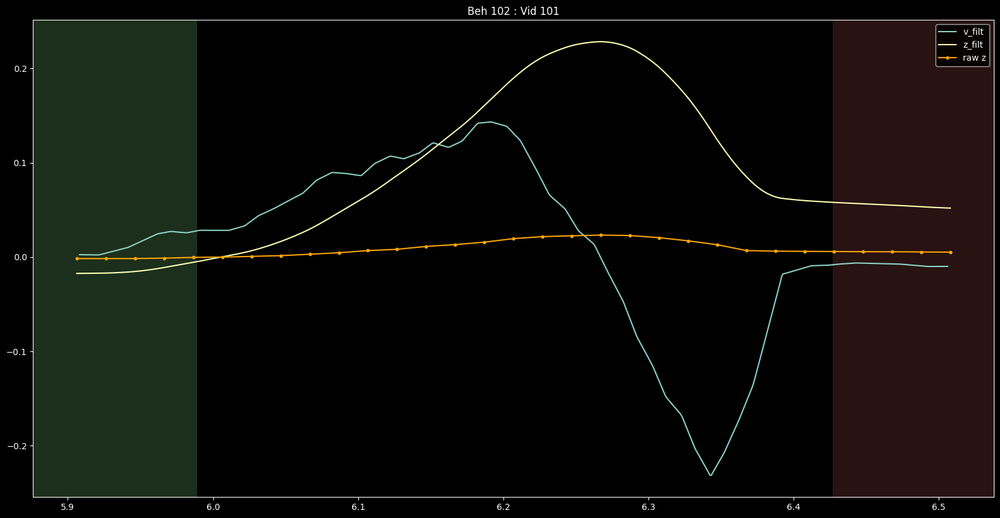

...

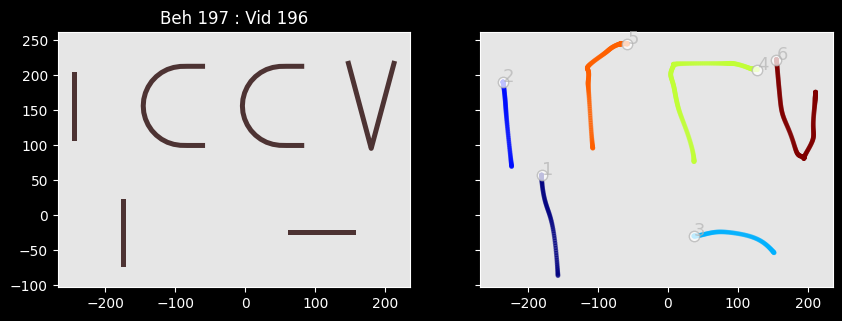

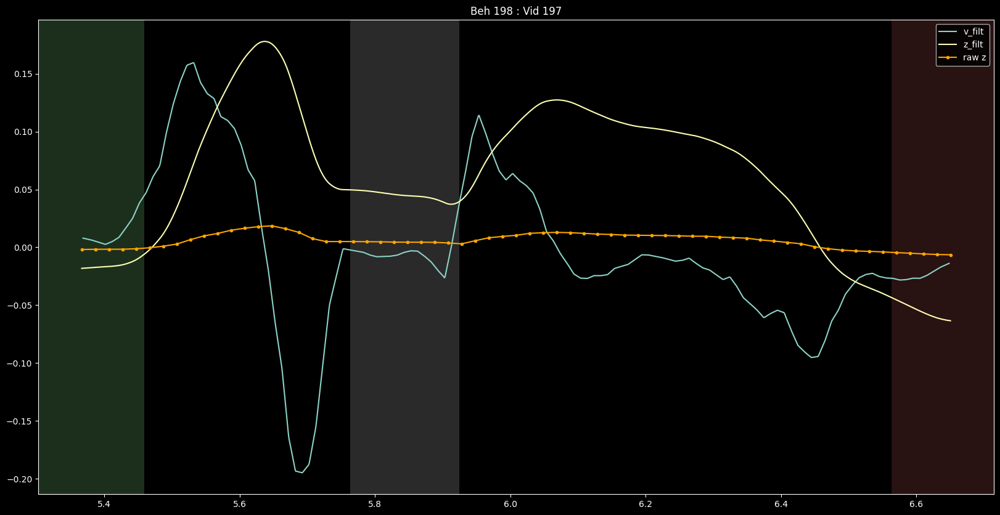

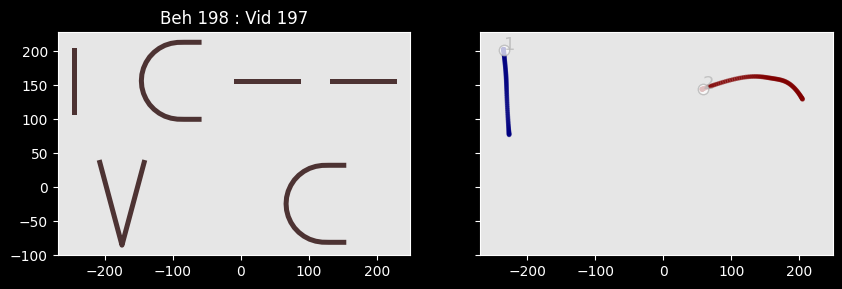

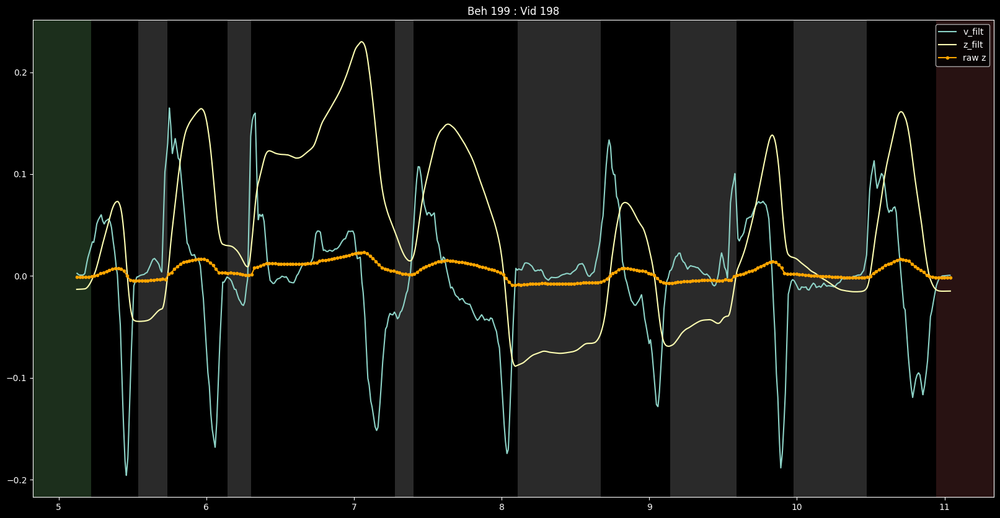

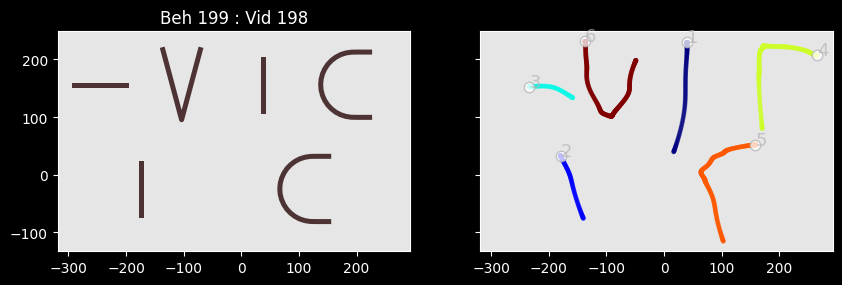

In [25]:
for trial,dat in dat_trials.items():
    strokes_task = getTrialsTaskAsStrokes(fd,trial)
    strokes_monkey = getTrialsStrokesByPeanuts(fd,trial)
    if len(dat) == 0:
        continue
    if trial in range(100,200):
        plotTrialsTrajectories(dat,trial)
        fig,ax = plt.subplots(1,2,figsize=[10,20],sharex=True,sharey=True)
        plotDatStrokes(strokes_task, ax[0], clean_task=True)
        plotDatStrokes(strokes_monkey,ax[1])
        ax[0].set_title(f'Beh {trial} : Vid {trial-1}')
        

        